In [1]:
import numpy as np
import pandas as pd

from pathlib import Path
from typing import *

import torch
import torch.optim as optim

In [2]:
from fastai import *
from fastai.vision import *
from fastai.text import *
from fastai.callbacks import *
from fastai.metrics import *
from pytorch_transformers import RobertaTokenizer

In [3]:
#%%bash
#pip install pytorch-pretrained-bert

In [4]:
SEED_NUM = 42
def seed_all(seed_value):
    random.seed(seed_value) # Python
    np.random.seed(seed_value) # cpu vars
    torch.manual_seed(seed_value) # cpu  vars
    
    if torch.cuda.is_available(): 
        torch.cuda.manual_seed(seed_value)
        torch.cuda.manual_seed_all(seed_value) # gpu vars
        torch.backends.cudnn.deterministic = True  #needed
        torch.backends.cudnn.benchmark = False
seed_all(SEED_NUM)

In [5]:
device='cuda'
torch.cuda.set_device(5)

In [6]:
from sklearn.model_selection import train_test_split

In [7]:
DATA_ROOT = Path("") 

train_pre, test = [pd.read_csv(DATA_ROOT / fname) for fname in ["task2_trainset.csv", "task2_private_testset.csv"]]
####### add dataset pseudo label
#dataset = pd.read_csv('dataset.csv')
###### add dataset pseudo label
dataset = pd.read_csv('dataset_predictions.csv')
test_for_train = pd.read_csv('test_predictions.csv')
dataset

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,695875,"In this paper, we review briefly the different...",1,1,0,0
1,2207358,An algorithm that could be implemented at a mo...,1,1,0,0
2,5536715,In Workflow Management Systems (WFMSs) safety ...,1,0,0,0
3,9313061,The huge growth of mobile and handheld devices...,0,1,0,0
4,9560197,Social networks and natural resource managemen...,1,0,0,0
...,...,...,...,...,...,...
707975,2961228254,"Models of iterated computation, such as (compl...",1,0,0,0
707976,2961343110,Wireless sensor network (WSN) operates under s...,1,1,0,0
707977,2961730795,The present invention concerns a method for as...,1,0,0,0
707978,2962002472,"Three-way decisions, as a decision-making mode...",1,0,0,0


In [8]:
test_for_train

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,T00001,Mobile Crowdsensing is a promising paradigm fo...,1,0,0,0
1,T00002,A keyboard has many function keys and each fun...,0,1,0,0
2,T00003,With increasing availability of communication ...,1,1,0,0
3,T00004,The clustered planarity problem c-planarity ...,1,0,0,0
4,T00005,We introduce a genetic programming method for ...,1,1,0,0
...,...,...,...,...,...,...
19995,T19996,We consider theoretical limits of partial secr...,1,0,0,0
19996,T19997,With the stagnation of processor core performa...,1,1,0,0
19997,T19998,This paper shows that structured transmission ...,1,0,0,0
19998,T19999,In this paper we present a Fuzzy Logic control...,0,1,0,0


In [9]:
train_pre.drop('Title',axis=1,inplace=True)
train_pre.drop('Categories',axis=1,inplace=True)
test.drop('Title',axis=1,inplace=True)
test.drop('Categories',axis=1,inplace=True)
####################################################
train_pre.drop('Created Date',axis=1, inplace=True)
train_pre.drop('Authors',axis=1,inplace=True)
test.drop('Created Date',axis=1, inplace=True)
test.drop('Authors',axis=1,inplace=True)

In [10]:
train_pre['THEORETICAL']=0
train_pre['ENGINEERING']=0
train_pre['EMPIRICAL']=0
train_pre['OTHERS']=0
for i in range(train_pre.Id.count()):
    string = train_pre['Task 2'][i]
    train_pre['THEORETICAL'][i] = 1 if (string.find('THEORETICAL')!=-1) else 0
    train_pre['ENGINEERING'][i] = 1 if (string.find('ENGINEERING')!=-1) else 0
    train_pre['EMPIRICAL'][i] = 1 if (string.find('EMPIRICAL')!=-1) else 0
    train_pre['OTHERS'][i] = 1 if (string.find('OTHERS')!=-1) else 0   
train_pre.head()

/home/IPL915/.conda/envs/KIWI/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/home/IPL915/.conda/envs/KIWI/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/home/IPL915/.conda/envs/KIWI/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/home/IPL915/.co

,Id,Abstract,Task 2,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,D00001,Rapid popularity of Internet of Things (IoT) a...,THEORETICAL,1,0,0,0
1,D00002,"In this paper, we address the problem of compu...",THEORETICAL,1,0,0,0
2,D00003,High quality upsampling of sparse 3D point clo...,ENGINEERING,0,1,0,0
3,D00004,Internet is the main source of information now...,EMPIRICAL,0,0,1,0
4,D00005,Automated Facial Expression Recognition (FER) ...,ENGINEERING,0,1,0,0


In [11]:
train_pre.drop('Task 2',axis=1,inplace=True)
train_pre

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,D00001,Rapid popularity of Internet of Things (IoT) a...,1,0,0,0
1,D00002,"In this paper, we address the problem of compu...",1,0,0,0
2,D00003,High quality upsampling of sparse 3D point clo...,0,1,0,0
3,D00004,Internet is the main source of information now...,0,0,1,0
4,D00005,Automated Facial Expression Recognition (FER) ...,0,1,0,0
...,...,...,...,...,...,...
6995,D06996,We have witnessed the discovery of many techni...,1,1,0,0
6996,D06997,State-of-the-art slot filling models for goal-...,0,1,0,0
6997,D06998,Real-time semantic segmentation plays an impor...,0,1,0,0
6998,D06999,We propose a neural embedding algorithm called...,1,0,1,0


In [12]:

#train = train_pre


############### train increase 
#train = train_pre.append(dataset)
train = train_pre.append(test_for_train)
train.reset_index(inplace=True,drop=True)
############### train increase



###### add dataset pseudo label
#del test
#test = dataset
###### add dataset pseudo label

In [13]:
def text_clean(df1):    
    for index,row in df1.iterrows():
        row['Abstract']=row['Abstract'].replace("$$$", " ")
        #df1['Abstract'][i]=df1['Abstract'][i].replace(".", " ")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("->", "to")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("~", " ")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("&", "and")
        #df1['Abstract'][i]=df1['Abstract'][i].replace(",", " ")
        #df1['Abstract'][i]=df1['Abstract'][i].replace(":", " ")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("%", " percentage")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("C++", "c plus plus")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("w.r.t.", "in respect of")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("e.g.", "example")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("etc.", "and so on")
        #df1['Abstract'][i]=df1['Abstract'][i].replace("'s'", "s")       
        row['Abstract']=row['Abstract'].replace("(A)", " ")
        row['Abstract']=row['Abstract'].replace("(B)", " ")
        row['Abstract']=row['Abstract'].replace("(C)", " ")
        row['Abstract']=row['Abstract'].replace("(D)", " ")
        row['Abstract']=row['Abstract'].replace("(a)", " ")
        row['Abstract']=row['Abstract'].replace("(b)", " ")
        row['Abstract']=row['Abstract'].replace("(c)", " ")
        row['Abstract']=row['Abstract'].replace("(d)", " ")
        row['Abstract']=row['Abstract'].replace("(e)", " ")
        row['Abstract']=row['Abstract'].replace("(1)", " ")
        row['Abstract']=row['Abstract'].replace("(2)", " ")
        row['Abstract']=row['Abstract'].replace("(3)", " ")
        row['Abstract']=row['Abstract'].replace("(4)", " ")
        row['Abstract']=row['Abstract'].replace("(5)", " ")
        row['Abstract']=row['Abstract'].replace("(i)", " ")
        row['Abstract']=row['Abstract'].replace("(ii)", " ")
        row['Abstract']=row['Abstract'].replace("(iii)", " ")
        row['Abstract']=row['Abstract'].replace("(iv)", " ")
        row['Abstract']=row['Abstract'].replace("i)", " ")
        row['Abstract']=row['Abstract'].replace("ii)", " ")
        row['Abstract']=row['Abstract'].replace("iii)", " ")
        row['Abstract']=row['Abstract'].replace("iv)", " ")
        row['Abstract']=row['Abstract'].replace("(", " ")
        row['Abstract']=row['Abstract'].replace(")", " ")
text_clean(train)
text_clean(test)

In [14]:
train, val = train_test_split(train, shuffle=True, test_size=0.2, random_state=SEED_NUM)

In [15]:
train.head()

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
14672,T07673,Runge-Kutta methods are the classic family of ...,1,0,0,0
20803,T13804,We present a study in Distributed Deep Reinfor...,0,1,1,0
1329,D01330,We propose two multimodal deep learning archit...,0,1,1,0
8064,T01065,We consider allcast and multicast flow problem...,1,0,0,0
19781,T12782,The proliferation of commercial cloud computin...,0,0,1,0


In [16]:
train['Abstract'][0]

'Rapid popularity of Internet of Things (IoT) and cloud computing permits neuroscientists to collect multilevel and multichannel brain data to better understand brain functions, diagnose diseases, and devise treatments.$$$To ensure secure and reliable data communication between end-to-end (E2E) devices supported by current IoT and cloud infrastructure, trust management is needed at the IoT and user ends.$$$This paper introduces a Neuro-Fuzzy based Brain-inspired trust management model (TMM) to secure IoT devices and relay nodes, and to ensure data reliability.$$$The proposed TMM utilizes node behavioral trust and data trust estimated using Adaptive Neuro-Fuzzy Inference System and weighted-additive methods respectively to assess the nodes trustworthiness.$$$In contrast to the existing fuzzy based TMMs, the NS2 simulation results confirm the robustness and accuracy of the proposed TMM in identifying malicious nodes in the communication network.$$$With the growing usage of cloud based Io

In [17]:
val.head()

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
5312,D05313,We present a uniform method for translating an...,1,0,0,0
18357,T11358,We present a Bayesian framework for reconstruc...,1,0,0,0
6428,D06429,Generating natural questions from an image is ...,1,1,0,0
15414,T08415,The work presents a comparative assessment of ...,0,1,0,0
10610,T03611,This article describes the Aalto University en...,0,0,1,0


In [18]:
test.head()

,Id,Abstract
0,T20001,Many real-world analytics problems involve two...
1,T20002,The spectrum of a first-order logic sentence i...
2,T20003,"In this paper, we propose a novel sufficient d..."
3,T20004,As the features from the traditional Local Bin...
4,T20005,Designing search algorithms for finding global...


In [19]:
seed_all(SEED_NUM)

In [20]:
# Creating a config object to store task specific information
class Config(dict):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        for k, v in kwargs.items():
            setattr(self, k, v)
    
    def set(self, key, val):
        self[key] = val
        setattr(self, key, val)
        
config = Config(
    testing=False,    
    roberta_model_name='roberta-large', # roberta-basecan also be exchnaged with roberta-large 
    max_lr=1e-5,
    epochs=4,
    use_fp16=True,
    bs=32, 
    max_seq_len=330, 
    num_labels = 6,
    hidden_dropout_prob=.05,
    hidden_size=1024, # 1024 for roberta-large 768 for base
    start_tok = "<s>",
    end_tok = "</s>",
)

In [21]:
label_cols  = ["THEORETICAL", "ENGINEERING", "EMPIRICAL", "OTHERS"]
feat_cols  = ["Abstract"]


In [22]:
class FastAiRobertaTokenizer(BaseTokenizer):
    """Wrapper around RobertaTokenizer to be compatible with fastai"""
    def __init__(self, tokenizer: RobertaTokenizer, max_seq_len: int=128, **kwargs): 
        self._pretrained_tokenizer = tokenizer
        self.max_seq_len = max_seq_len 
    def __call__(self, *args, **kwargs): 
        return self 
    def tokenizer(self, t:str) -> List[str]: 
        """Adds Roberta bos and eos tokens and limits the maximum sequence length""" 
        return [config.start_tok] + self._pretrained_tokenizer.tokenize(t)[:self.max_seq_len - 2] + [config.end_tok]

In [23]:
if config.testing:
    train = train.head(1024)
    val = val.head(1024)
    test = test.head(1024)

In following code snippets, we need to wrap BERT vocab and BERT tokenizer with Fastai modules

In [24]:
roberta_tok = RobertaTokenizer.from_pretrained("roberta-large")

fastai_tokenizer = Tokenizer(tok_func=FastAiRobertaTokenizer(roberta_tok, max_seq_len=config.max_seq_len), 
                             pre_rules=[], post_rules=[])

In [25]:
#fastai_bert_vocab = Vocab(list(bert_tok.vocab.keys()))
# create fastai vocabulary for roberta
path = Path()
roberta_tok.save_vocabulary(path)

with open('vocab.json', 'r') as f:
    roberta_vocab_dict = json.load(f)
fastai_roberta_vocab = Vocab(list(roberta_vocab_dict.keys()))

Alternatively, we can pass our own list of Preprocessors to the databunch (this is effectively what is happening behind the scenes)

In [26]:
# Setting up pre-processors
class RobertaTokenizeProcessor(TokenizeProcessor):
    def __init__(self, tokenizer):
         super().__init__(tokenizer=tokenizer, include_bos=False, include_eos=False)

class RobertaNumericalizeProcessor(NumericalizeProcessor):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, vocab=fastai_roberta_vocab, **kwargs)


def get_roberta_processor(tokenizer:Tokenizer=None, vocab:Vocab=None):
    """
    Constructing preprocessors for Roberta
    We remove sos and eos tokens since we add that ourselves in the tokenizer.
    We also use a custom vocabulary to match the numericalization with the original Roberta model.
    """
    return [RobertaTokenizeProcessor(tokenizer=tokenizer), NumericalizeProcessor(vocab=vocab)]

In [27]:
class BertDataBunch(TextDataBunch):
    @classmethod
    def from_df(cls, path:PathOrStr, train_df:DataFrame, valid_df:DataFrame, test_df:Optional[DataFrame]=None,
                tokenizer:Tokenizer=None, vocab:Vocab=None, classes:Collection[str]=None, text_cols:IntsOrStrs=1,
                label_cols:IntsOrStrs=0, label_delim:str=None, **kwargs) -> DataBunch:
        "Create a `TextDataBunch` from DataFrames."
        p_kwargs, kwargs = split_kwargs_by_func(kwargs, get_roberta_processor)
        # use our custom processors while taking tokenizer and vocab as kwargs
        processor = get_roberta_processor(tokenizer=fastai_tokenizer, vocab=fastai_roberta_vocab)
        if classes is None and is_listy(label_cols) and len(label_cols) > 1: classes = label_cols
        src = ItemLists(path, TextList.from_df(train_df, path, cols=text_cols, processor=processor),
                        TextList.from_df(valid_df, path, cols=text_cols, processor=processor))
        src = src.label_for_lm() if cls==TextLMDataBunch else src.label_from_df(cols=label_cols, classes=classes)
        if test_df is not None: src.add_test(TextList.from_df(test_df, path, cols=text_cols))
        return src.databunch(**kwargs)

In this project, we will be using Databunch which is easier to create and use.

In [28]:
# this will produce a virtually identical databunch to the code above
data = BertDataBunch.from_df(".", train, val, test,
                  tokenizer=fastai_tokenizer,
                  vocab=fastai_roberta_vocab,
                  text_cols=feat_cols,
                  label_cols=label_cols,
                  bs=config.bs,
                  collate_fn=partial(pad_collate, pad_first=False, pad_idx=0),
             )


In [29]:
data.show_batch()

text,target
"<s> ĠThe Ġapplication Ġof Ġpsych ophys iology Ġin Ġhuman - computer Ġinteraction Ġis Ġa Ġgrowing Ġfield Ġwith Ġsignificant Ġpotential Ġfor Ġfuture Ġsmart Ġpersonal ised Ġsystems . ĠWorking Ġin Ġthis Ġemerging Ġfield Ġrequires Ġcomprehension Ġof Ġan Ġarray Ġof Ġphysiological Ġsignals Ġand Ġanalysis Ġtechniques . ĠMethods Ġto Ġstudy Ġcentral Ġnervous Ġsystem Ġ ĠCNS Ġ Ġare Ġusually Ġexpensive Ġand Ġlabor ious . ĠHowever , Ġelectro ence phal ography Ġ ĠEEG Ġ Ġis Ġone",OTHERS
<s> ĠWe Ġpresent Ġa Ġtop ology - based Ġmethod Ġfor Ġmesh - part ition ing Ġin Ġthree - dimensional Ġdiscrete Ġfracture Ġnetwork Ġ ĠDF N Ġ Ġsimulations Ġthat Ġtakes Ġadvantage Ġof Ġthe Ġintrinsic Ġmulti - level Ġnature Ġof Ġa ĠDF N . ĠDF N Ġmodels Ġare Ġused Ġto Ġsimulate Ġflow Ġand Ġtransport Ġthrough Ġlow - per me ability Ġfracture Ġmedia Ġin Ġthe Ġsubs ur face Ġby Ġexplicitly Ġrepresenting Ġfractures Ġas,ENGINEERING
"<s> ĠGiven Ġan Ġembedded Ġplan ar Ġac y cl ic Ġdig raph ĠG , Ġwe Ġdefine Ġthe Ġproblem Ġof Ġ"" acy cl ic Ġham ilton ian Ġpath Ġcompletion Ġwith Ġcrossing Ġminim ization Ġ ĠA cycl ic - HP CC M Ġ"" Ġto Ġbe Ġthe Ġproblem Ġof Ġdetermining Ġan Ġham ilton ian Ġpath Ġcompletion Ġset Ġof Ġedges Ġsuch Ġthat , Ġwhen Ġthese Ġedges Ġare Ġembedded Ġon ĠG , Ġthey Ġcreate Ġthe",THEORETICAL
"<s> ĠQuantum - dot Ġcellular Ġautom ata Ġ ĠQ CA Ġ Ġis Ġa Ġlow - power , Ġnon - von - Ne umann , Ġgeneral - purpose Ġparadigm Ġfor Ġclassical Ġcomputing Ġusing Ġtransistor - free Ġlogic . ĠAn Ġelementary ĠQ CA Ġdevice Ġcalled Ġa Ġ"" cell "" Ġis Ġmade Ġfrom Ġa Ġsystem Ġof Ġcoupled Ġquantum Ġdots Ġwith Ġa Ġfew Ġmobile Ġcharges . ĠThe Ġcell 's Ġcharge Ġconfiguration Ġenc odes Ġa",ENGINEERING
"<s> ĠObjective : ĠPatient Ġnotes Ġin Ġelectronic Ġhealth Ġrecords Ġ ĠE HR s Ġ Ġmay Ġcontain Ġcritical Ġinformation Ġfor Ġmedical Ġinvestigations . ĠHowever , Ġthe Ġvast Ġmajority Ġof Ġmedical Ġinvestigators Ġcan Ġonly Ġaccess Ġde - identified Ġnotes , Ġin Ġorder Ġto Ġprotect Ġthe Ġconfidentiality Ġof Ġpatients . ĠIn Ġthe ĠUnited ĠStates , Ġthe ĠHealth ĠInsurance ĠPort ability Ġand ĠAccountability ĠAct Ġ ĠHIP AA Ġ Ġdefines Ġ18 Ġtypes Ġof Ġprotected Ġhealth",ENGINEERING


# Model

In [30]:
seed_all(42)

In [31]:
import torch.nn as nn
from pytorch_transformers import RobertaModel

# defining our model architecture 
class CustomRobertaModel(nn.Module):
    def __init__(self,num_labels=4):
        super(CustomRobertaModel,self).__init__()
        self.num_labels = num_labels
        self.roberta = RobertaModel.from_pretrained(config.roberta_model_name)
        self.dropout = nn.Dropout(config.hidden_dropout_prob)
        self.classifier = nn.Linear(config.hidden_size, num_labels) # defining final output layer
        
    def forward(self, input_ids, token_type_ids=None, attention_mask=None, labels=None):
        _ , pooled_output = self.roberta(input_ids, token_type_ids, attention_mask) # 
        logits = self.classifier(pooled_output)        
        return logits

In [32]:
roberta_model = CustomRobertaModel()

learn = Learner(data,roberta_model,metrics=[fbeta],callback_fns=ShowGraph)

In [33]:
if config.use_fp16: learn=learn.to_fp16()

epoch,train_loss,valid_loss,fbeta,time
0,0.368179,0.331041,0.819919,05:45
1,0.255956,0.241110,0.864070,05:46
2,0.217012,0.202549,0.889544,05:47
3,0.188101,0.180236,0.898673,05:45
4,0.178037,0.170198,0.901667,05:45
5,0.161803,0.171755,0.903272,05:45
6,0.153179,0.158643,0.907097,05:48
7,0.144132,0.156179,0.909140,05:47
8,0.139749,0.154039,0.908864,05:46
9,0.135724,0.152233,0.911280,05:45


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

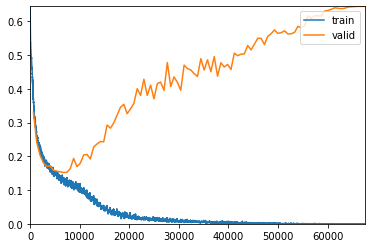

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

In [34]:
learn.model.roberta.train() # setting roberta to train as it is in eval mode by default
learn.fit_one_cycle(100, max_lr=config.max_lr)

In [34]:
learn.recorder.plot_losses()

AttributeError: 'Learner' object has no attribute 'recorder'

epoch,train_loss,valid_loss,fbeta,time
0,0.207906,0.182664,0.894056,05:51
1,0.171205,0.180632,0.897208,05:50
2,0.127958,0.150937,0.909610,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

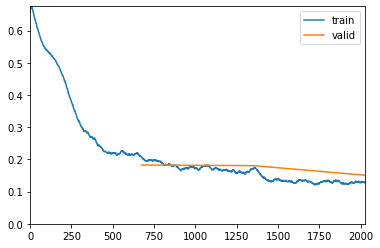

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.203386,0.182995,0.896243,05:47
1,0.161085,0.155031,0.908169,05:50
2,0.128379,0.149028,0.910842,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

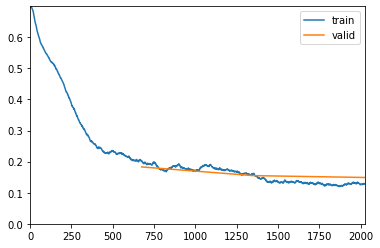

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.214916,0.194352,0.886179,05:50
1,0.180192,0.160013,0.903086,05:49
2,0.131350,0.149997,0.910336,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

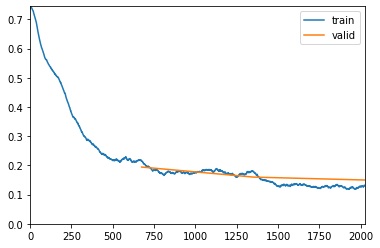

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.202811,0.182252,0.894204,05:48
1,0.164855,0.155062,0.907070,05:50
2,0.122093,0.149990,0.910398,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

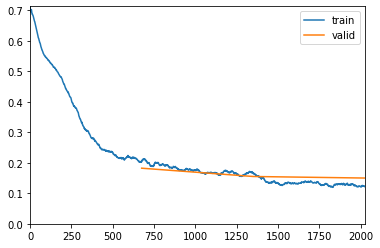

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.197496,0.184877,0.894052,05:51
1,0.165785,0.160098,0.903461,05:52
2,0.125381,0.146969,0.910942,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

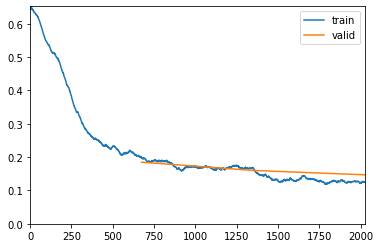

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.209267,0.196785,0.891294,05:49
1,0.171213,0.181393,0.894627,05:48
2,0.121620,0.149534,0.910125,05:50


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

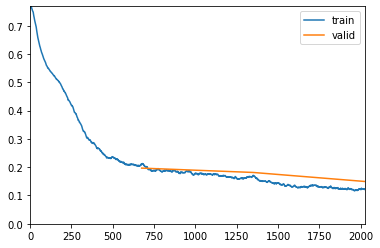

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.212559,0.190722,0.890689,05:52
1,0.161770,0.158114,0.905685,05:51
2,0.120079,0.152630,0.909885,05:50


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

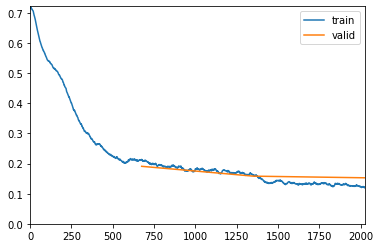

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.212927,0.203565,0.881273,05:52
1,0.156641,0.175895,0.898166,05:50
2,0.124673,0.148678,0.910614,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

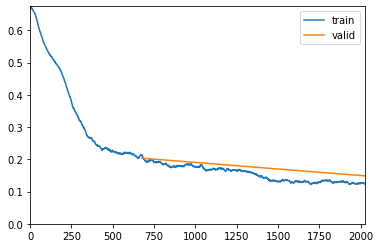

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.208650,0.195252,0.891948,05:52
1,0.154218,0.157542,0.905114,05:50
2,0.125087,0.150998,0.908890,05:50


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

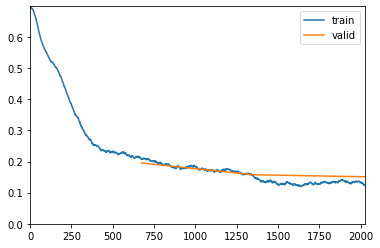

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.204807,0.197533,0.887760,05:52
1,0.161476,0.153916,0.905128,05:53
2,0.125954,0.148443,0.910893,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

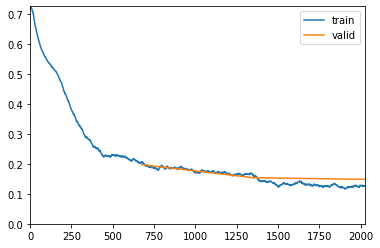

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.207560,0.182613,0.896048,05:53
1,0.154740,0.160951,0.904670,05:53
2,0.130164,0.149564,0.910054,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

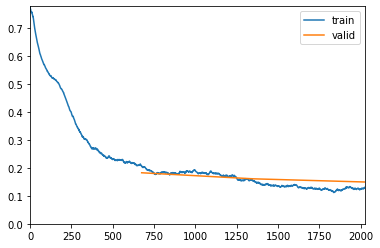

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.205591,0.193040,0.890052,05:51
1,0.163686,0.161557,0.905595,05:49
2,0.118449,0.150173,0.910815,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

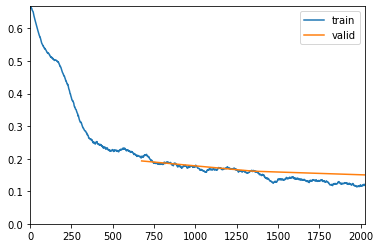

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.199774,0.186439,0.891016,05:49
1,0.165517,0.153905,0.907816,05:49
2,0.120450,0.149274,0.910419,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

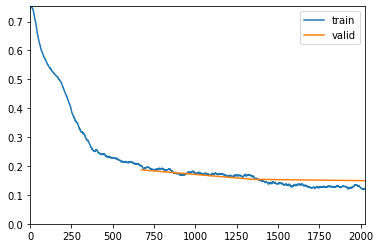

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.205906,0.188298,0.892948,05:49
1,0.164800,0.164526,0.904285,05:48
2,0.125302,0.150409,0.911170,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

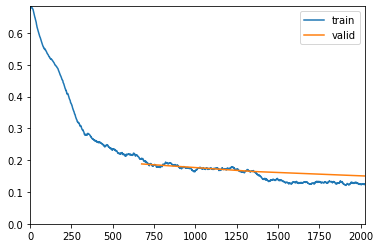

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.203956,0.190608,0.890764,05:47
1,0.166850,0.173141,0.896777,05:48
2,0.135753,0.151630,0.908746,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

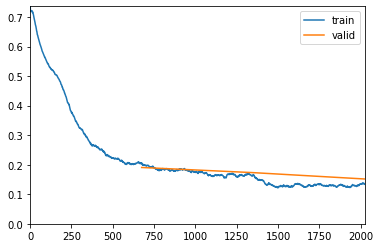

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.202927,0.172328,0.900638,05:51
1,0.157836,0.160116,0.902718,05:49
2,0.131118,0.148016,0.910561,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

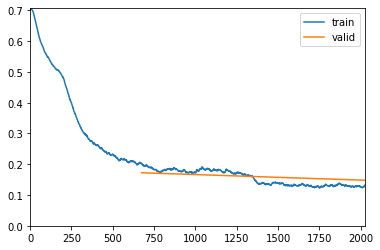

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.193300,0.177716,0.898541,05:47
1,0.160669,0.170107,0.902705,05:47
2,0.115168,0.151015,0.911286,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

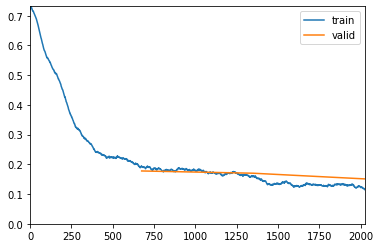

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.210040,0.195198,0.887892,05:48
1,0.153629,0.170020,0.901844,05:48
2,0.113049,0.151567,0.908719,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

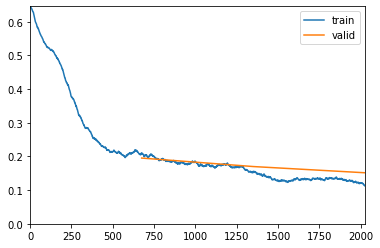

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.204099,0.178447,0.899783,05:47
1,0.167308,0.158644,0.904430,05:47
2,0.124395,0.149998,0.910237,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

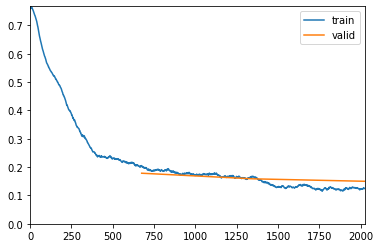

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.206291,0.177704,0.898546,05:47
1,0.162942,0.157831,0.905355,05:47
2,0.119930,0.150426,0.908285,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

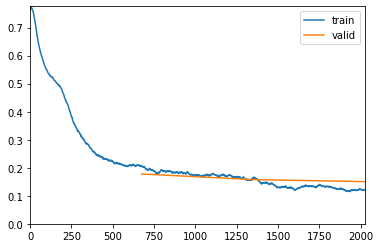

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.199566,0.184439,0.892781,05:50
1,0.160663,0.159400,0.905279,05:51
2,0.128217,0.149743,0.910355,05:50


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

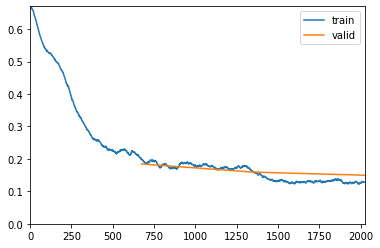

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.196127,0.185926,0.893746,05:47
1,0.157383,0.160721,0.905500,05:47
2,0.126731,0.151217,0.908688,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

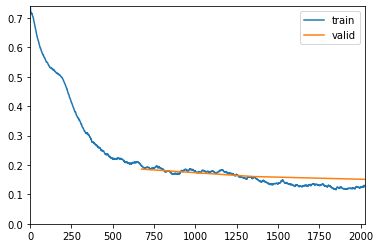

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.212953,0.179121,0.897070,05:50
1,0.165669,0.156660,0.904292,05:48
2,0.122249,0.151311,0.909684,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

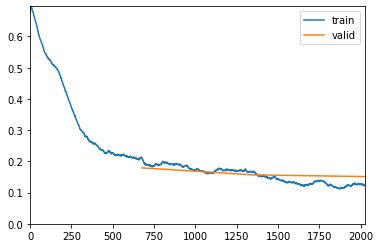

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.203506,0.181162,0.896321,05:48
1,0.163616,0.157498,0.907959,05:48
2,0.125643,0.149329,0.911191,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

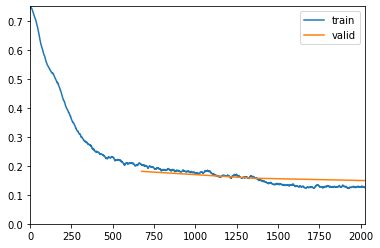

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.203791,0.192343,0.893860,05:49
1,0.160646,0.153766,0.909524,05:49
2,0.121903,0.147284,0.911471,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

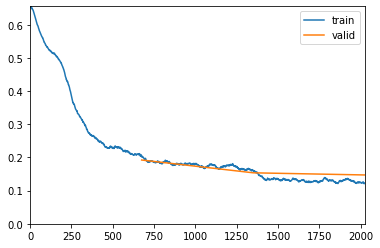

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.201689,0.173080,0.901575,05:48
1,0.166543,0.163804,0.904071,05:49
2,0.122550,0.147547,0.912368,05:50


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

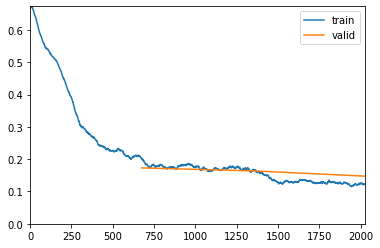

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.203397,0.172469,0.901079,05:50
1,0.154257,0.161224,0.904808,05:49
2,0.122979,0.148726,0.910575,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

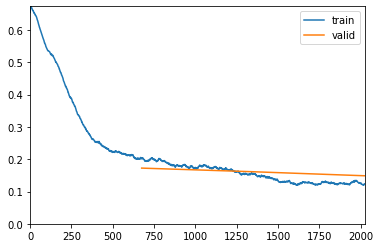

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.206449,0.183025,0.894679,05:47
1,0.161704,0.159946,0.903810,05:47
2,0.131407,0.152589,0.907428,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

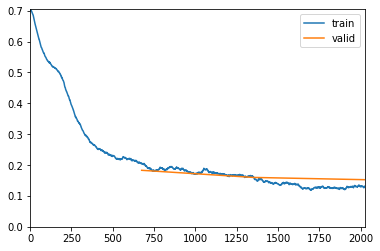

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.218367,0.190079,0.895311,05:48
1,0.159760,0.164080,0.903089,05:47
2,0.132216,0.149360,0.910232,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

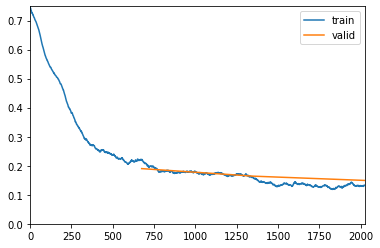

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.213213,0.183319,0.896144,05:48
1,0.162167,0.154637,0.909531,05:48
2,0.125266,0.149814,0.909388,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

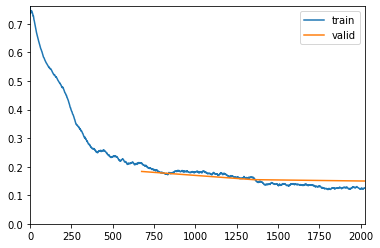

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.195383,0.183233,0.891857,05:48
1,0.170601,0.167488,0.901614,05:47
2,0.126198,0.148749,0.910458,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

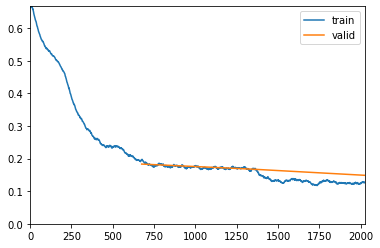

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.210202,0.189293,0.891701,05:50
1,0.166472,0.159746,0.905264,05:50
2,0.130367,0.149508,0.911860,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

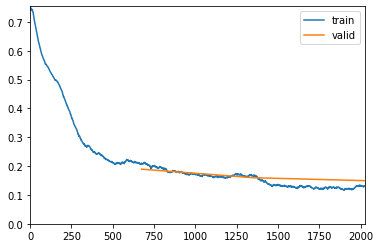

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.206900,0.219829,0.880688,05:47
1,0.165909,0.162092,0.904138,05:49
2,0.123525,0.149731,0.910976,05:54


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

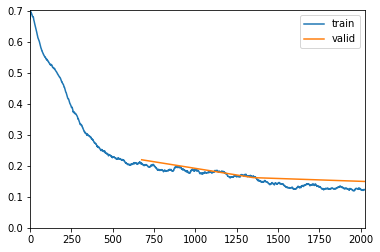

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.200799,0.181781,0.893129,05:47
1,0.165707,0.162657,0.900936,05:47
2,0.124473,0.150411,0.910156,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

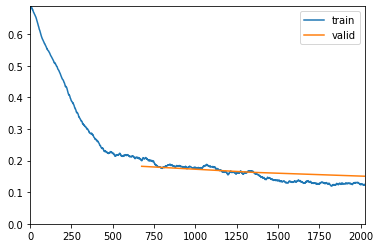

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.202653,0.178002,0.899878,05:47
1,0.153071,0.192343,0.885103,05:47
2,0.122841,0.149233,0.911572,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

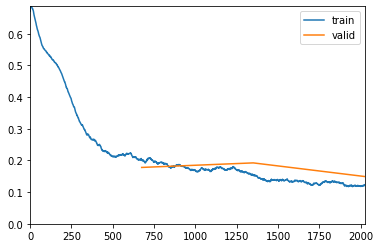

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.207071,0.187641,0.891372,05:47
1,0.160293,0.161193,0.905343,05:48
2,0.130321,0.150518,0.909926,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

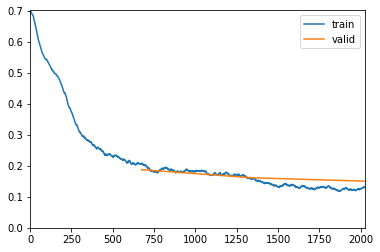

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.205994,0.186761,0.891386,05:50
1,0.158928,0.156278,0.906319,05:53
2,0.128568,0.149237,0.912014,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

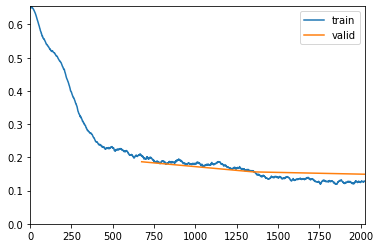

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.207480,0.180504,0.900720,05:52
1,0.165348,0.158679,0.903921,05:51
2,0.130099,0.150446,0.909417,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

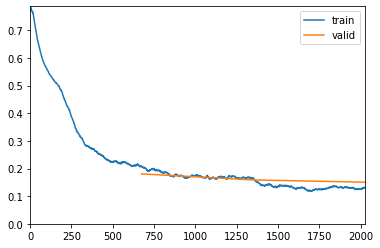

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.210047,0.233154,0.869611,05:51
1,0.169239,0.163276,0.905029,05:50
2,0.118668,0.149389,0.909788,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

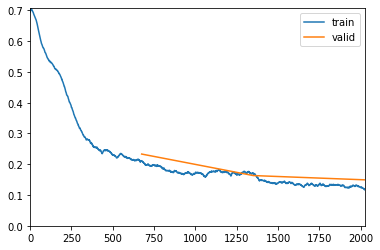

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.222006,0.194605,0.892223,05:50
1,0.171832,0.153328,0.906972,05:51
2,0.127373,0.149729,0.909382,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

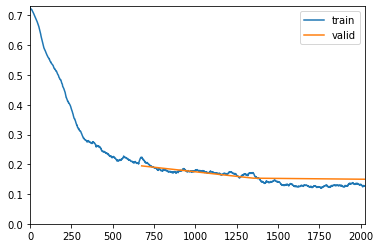

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.211093,0.179761,0.897119,05:51
1,0.174371,0.162821,0.905781,05:52
2,0.122812,0.150807,0.909931,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

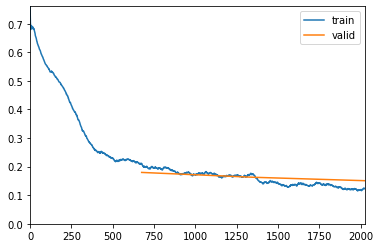

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.207461,0.188401,0.892704,05:52
1,0.156224,0.172584,0.898051,05:53
2,0.121389,0.150685,0.909520,05:54


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

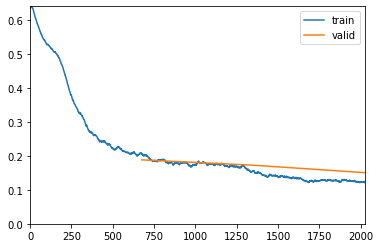

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.206841,0.181349,0.896255,05:55
1,0.158195,0.157301,0.907581,05:55
2,0.121587,0.151258,0.910665,05:53


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

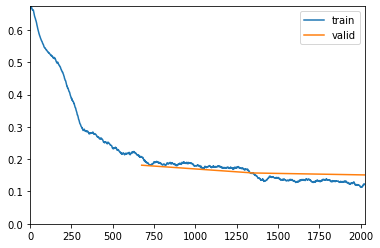

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.202074,0.179733,0.899151,05:52
1,0.162281,0.158408,0.907835,05:51
2,0.127836,0.149664,0.910889,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

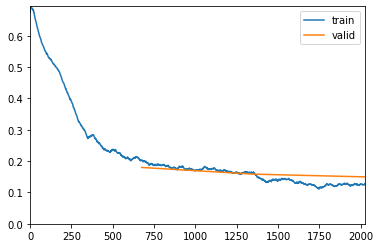

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.195311,0.175727,0.895996,05:52
1,0.150362,0.157666,0.907463,05:51
2,0.114008,0.148175,0.911955,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

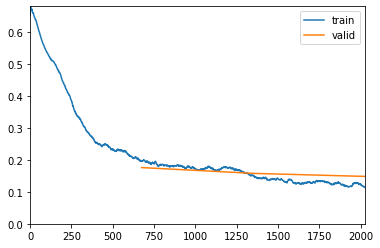

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.209294,0.186268,0.891632,05:52
1,0.163634,0.158596,0.907138,05:52
2,0.122338,0.148646,0.911372,05:53


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

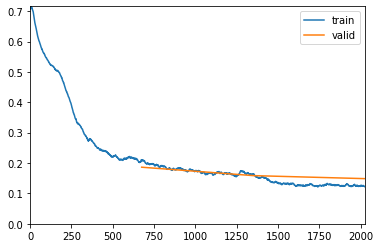

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.208473,0.188868,0.891848,05:52
1,0.174336,0.158679,0.905779,05:53
2,0.121454,0.152219,0.908964,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

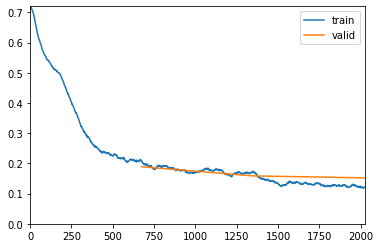

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.204614,0.197045,0.890746,05:54
1,0.159698,0.164037,0.901544,05:55
2,0.132692,0.150466,0.907746,05:56


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

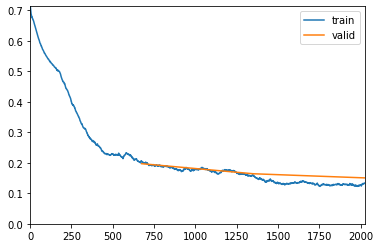

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.212529,0.184173,0.890876,05:53
1,0.164932,0.158142,0.906925,05:52
2,0.128534,0.150871,0.908817,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

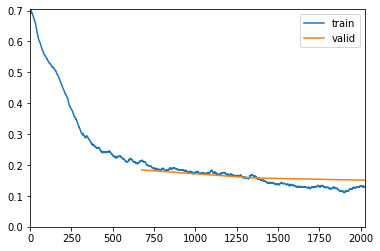

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.206802,0.175789,0.897897,05:53
1,0.162103,0.154889,0.908396,05:51
2,0.125427,0.149639,0.910708,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

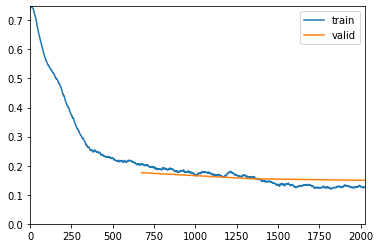

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.197739,0.180888,0.898440,05:52
1,0.165443,0.155313,0.908328,05:51
2,0.124807,0.150414,0.910168,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

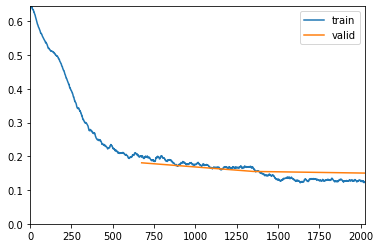

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.200787,0.181403,0.894116,05:53
1,0.162343,0.161494,0.905811,05:53
2,0.120124,0.150486,0.909764,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

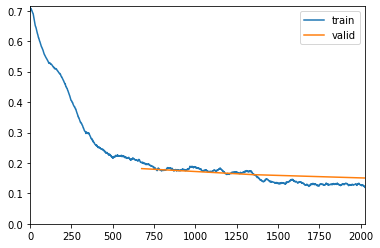

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.208437,0.192572,0.889496,05:52
1,0.160037,0.165167,0.900165,05:51
2,0.126246,0.151560,0.907798,05:53


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

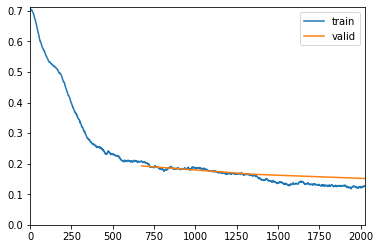

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.208979,0.190789,0.888643,05:54
1,0.167273,0.169603,0.901654,05:53
2,0.126506,0.150358,0.909551,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

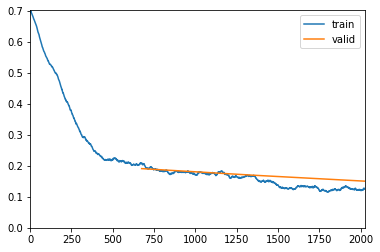

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.202241,0.185285,0.892076,05:50
1,0.160864,0.158544,0.905776,05:48
2,0.132164,0.149465,0.911209,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

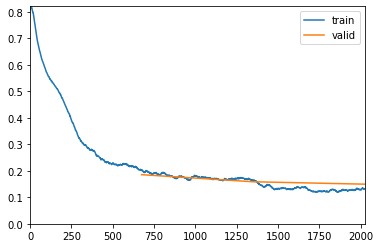

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.197325,0.193567,0.887869,05:48
1,0.154661,0.164956,0.903840,05:47
2,0.119293,0.150822,0.910583,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

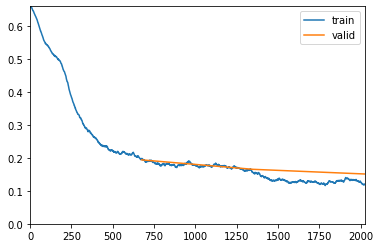

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.206458,0.189540,0.892612,05:47
1,0.166374,0.162343,0.904097,05:48
2,0.123491,0.150517,0.910513,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

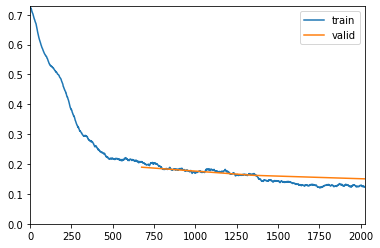

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.203891,0.185815,0.891862,05:47
1,0.163237,0.158956,0.907832,05:49
2,0.132531,0.149412,0.910062,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

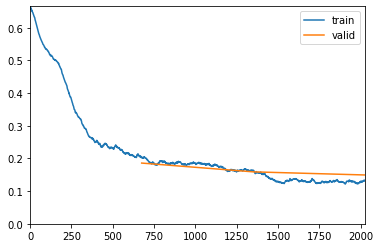

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.212460,0.211042,0.885173,05:50
1,0.165930,0.158268,0.902140,05:51
2,0.122855,0.150658,0.907928,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

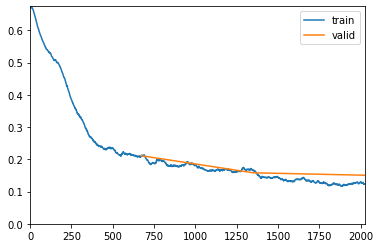

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.214497,0.182494,0.894403,05:48
1,0.165240,0.164696,0.903748,05:46
2,0.129591,0.150556,0.910597,05:48


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

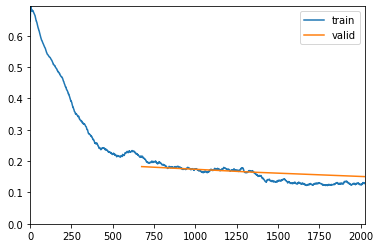

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.200480,0.182148,0.893382,05:48
1,0.164483,0.157101,0.905130,05:48
2,0.126691,0.148300,0.911101,05:49


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

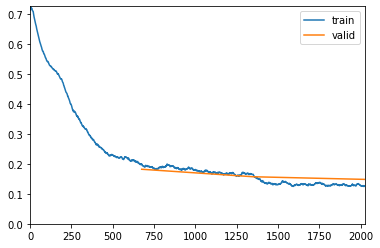

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.201321,0.174130,0.897198,05:48
1,0.168750,0.156998,0.907233,05:48
2,0.125803,0.148485,0.910577,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

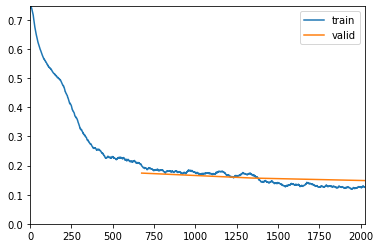

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.204898,0.177007,0.900219,05:47
1,0.165442,0.170773,0.901507,05:48
2,0.124968,0.152455,0.909252,05:47


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

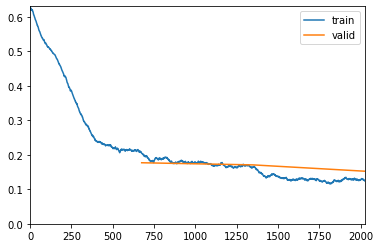

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.204503,0.181812,0.898129,05:48
1,0.164989,0.164012,0.901741,05:50
2,0.128522,0.150039,0.909947,05:52


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

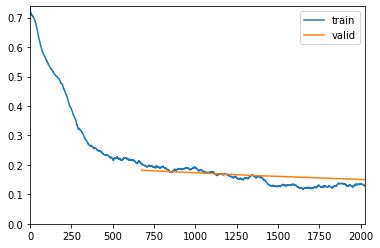

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

epoch,train_loss,valid_loss,fbeta,time
0,0.212624,0.183801,0.892467,05:51


A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

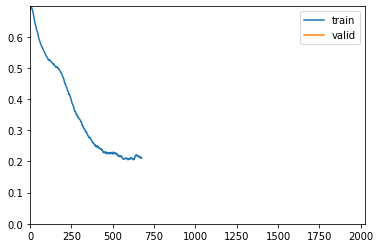

In [ ]:
seed = 42
min_val = 1
for i in range(1,1000000):
    seed_all(i)   
    roberta_model = CustomRobertaModel()
    learn = Learner(data,roberta_model,metrics=[fbeta],callback_fns=ShowGraph)
    if config.use_fp16: learn=learn.to_fp16()    
    learn.model.roberta.train() # setting roberta to train as it is in eval mode by default
    learn.fit_one_cycle(3, max_lr=config.max_lr)
    val = learn.validate()
    if(val[0]<min_val): 
        min_val=val[0]
        seed = i


In [ ]:
print(seed)
print(min_val)
print(i)

In [75]:
def get_preds_as_nparray(ds_type) -> np.ndarray:
    learn.model.roberta.eval()
    preds = learn.get_preds(ds_type)[0].detach().cpu().numpy()
    sampler = [i for i in data.dl(ds_type).sampler]
    reverse_sampler = np.argsort(sampler)
    ordered_preds = preds[reverse_sampler, :]
    pred_values = np.argmax(ordered_preds, axis=1)
    return ordered_preds, pred_values

In [76]:
#test_preds = get_preds_as_nparray(DatasetType.Test)
test_preds, test_preds_values = get_preds_as_nparray(DatasetType.Test)

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model requires special tokens in order to work. Please specify add_special_tokens=True in your encoding.
A sequence with no special tokens has been passed to the RoBERTa model. This model require

In [77]:
test_preds_values

array([0, 0, 0, 0, ..., 3, 1, 2, 1])

In [78]:
threshold_preds = (test_preds>=0.5).astype(int)
threshold_preds

array([[1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 1, 0, 0],
       ...,
       [0, 0, 0, 0],
       [0, 1, 0, 0],
       [0, 0, 1, 0],
       [0, 1, 0, 0]])

In [79]:
def SubmitGenerator(prediction, sampleFile, public=True, filename='prediction.csv'):
    """
    Args:
        prediction (numpy array)
        sampleFile (str)
        public (boolean)
        filename (str)
    """
    sample = pd.read_csv(sampleFile)
    submit = {}
    submit['order_id'] = list(sample.order_id.values)
    redundant = len(sample) - prediction.shape[0]
    if public:
        submit['THEORETICAL'] = list(prediction[:,0]) + [0]*redundant
        submit['ENGINEERING'] = list(prediction[:,1]) + [0]*redundant
        submit['EMPIRICAL'] = list(prediction[:,2]) + [0]*redundant
        submit['OTHERS'] = list(prediction[:,3]) + [0]*redundant
    else:
        submit['THEORETICAL'] = [0]*redundant + list(prediction[:,0])
        submit['ENGINEERING'] = [0]*redundant + list(prediction[:,1])
        submit['EMPIRICAL'] = [0]*redundant + list(prediction[:,2])
        submit['OTHERS'] = [0]*redundant + list(prediction[:,3])
    df = pd.DataFrame.from_dict(submit) 
    df.to_csv(filename,index=False)

In [80]:
SubmitGenerator(threshold_preds, 
                'task2_sample_submission.csv',
                False, 
                'task2_submission_ROBERT_private_final_2.csv')

In [81]:
public = pd.read_csv('task2_submission_ROBERT_public.csv')
private = pd.read_csv('task2_submission_ROBERT_private_final_2.csv')
final = public.copy()
for i in range(final.order_id.count()):
    if(public.THEORETICAL[i] == 1 or private.THEORETICAL[i] == 1):
        final.THEORETICAL[i] = 1
    else:
        final.THEORETICAL[i] == 0
    if(public.ENGINEERING[i] == 1 or private.ENGINEERING[i] == 1):
        final.ENGINEERING[i] = 1
    else:
        final.ENGINEERING[i] = 0
    if(public.EMPIRICAL[i] == 1 or private.EMPIRICAL[i] == 1):
        final.EMPIRICAL[i] = 1
    else:
        final.EMPIRICAL[i] = 0    
    if(public.OTHERS[i] == 1 or private.OTHERS[i] == 1):
        final.OTHERS[i] = 1
    else:
        final.OTHERS[i] = 0
final.to_csv("task2_submission_ROBERT_final_2.csv", index=False)
final

/home/IPL915/.conda/envs/KIWI/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/home/IPL915/.conda/envs/KIWI/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':
/home/IPL915/.conda/envs/KIWI/lib/python3.7/site-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()
/hom

,order_id,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,T00001,1,0,0,0
1,T00002,0,1,0,0
2,T00003,1,1,0,0
3,T00004,1,0,0,0
4,T00005,0,1,0,0
...,...,...,...,...,...
39995,T39996,0,1,0,0
39996,T39997,0,0,0,0
39997,T39998,0,1,0,0
39998,T39999,0,0,1,0


In [41]:
test['THEORETICAL']=0
test['ENGINEERING']=0
test['EMPIRICAL']=0
test['OTHERS']=0
test

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,T00001,Mobile Crowdsensing is a promising paradigm fo...,0,0,0,0
1,T00002,A keyboard has many function keys and each fun...,0,0,0,0
2,T00003,With increasing availability of communication ...,0,0,0,0
3,T00004,The clustered planarity problem c-planarity ...,0,0,0,0
4,T00005,We introduce a genetic programming method for ...,0,0,0,0
...,...,...,...,...,...,...
19995,T19996,We consider theoretical limits of partial secr...,0,0,0,0
19996,T19997,With the stagnation of processor core performa...,0,0,0,0
19997,T19998,This paper shows that structured transmission ...,0,0,0,0
19998,T19999,In this paper we present a Fuzzy Logic control...,0,0,0,0


In [42]:
###pusedo test label
test[label_cols] = threshold_preds
test.to_csv("test_predictions.csv", index=False)
test.head()

,Id,Abstract,THEORETICAL,ENGINEERING,EMPIRICAL,OTHERS
0,T00001,Mobile Crowdsensing is a promising paradigm fo...,1,0,0,0
1,T00002,A keyboard has many function keys and each fun...,0,1,0,0
2,T00003,With increasing availability of communication ...,1,1,0,0
3,T00004,The clustered planarity problem c-planarity ...,1,0,0,0
4,T00005,We introduce a genetic programming method for ...,1,1,0,0


In [ ]:
###pusedo label
dataset[label_cols] = threshold_preds
print(dataset.head())
dataset.to_csv("dataset_predictions.csv", index=False)

In [ ]:
import time
torch.cuda.empty_cache() 
time.sleep(100)